In [1]:
import numpy as np
from matplotlib import pylab as pl
from os import listdir
import imageio
import json
from HSM_WFN import *
import scipy
import time
from matplotlib.gridspec import GridSpec

%matplotlib inline

In [2]:
ITMX_data_direc = '../../../20181106_HeatupCooldown/ITMX_hws_data/'
ITMX_FileList = listdir(ITMX_data_direc)
ITMX_list = []

ITMY_data_direc = '../../../20181106_HeatupCooldown/ITMY_hws_data/'
ITMY_FileList = listdir(ITMY_data_direc)
ITMY_list = []


def load_json(FileList,data_direc):
    img_List=[]
    for i in range(len(FileList)):
        filename = data_direc+FileList[i]
        file = open(filename,'r', encoding='utf-8')
        try:
            array =json.load(file)
        except:
            print("Couldn't Load " +filename +", maybe bad file?")
            continue
        #array_reshape = array.reshape([1024,1024])
        #f = np.flip(array_reshape,0)
        file.close()
        img_List.append(array)
    
    return img_List
    

ITMX_list = load_json(ITMX_FileList,ITMX_data_direc)
ITMY_list = load_json(ITMY_FileList,ITMY_data_direc)

Couldn't Load ../../../20181106_HeatupCooldown/ITMX_hws_data/ITMX_1225654787.json, maybe bad file?


In [3]:
ITMX_list[0].keys()

dict_keys(['avImage', 'avGradients', 'optic', 'numberOfAvg'])

In [4]:
ITMX_data_direc = '../../../20181106_HeatupCooldown/ITMX_hws_data/'
ITMX_FileList = listdir(ITMX_data_direc)

ITMY_data_direc = '../../../20181106_HeatupCooldown/ITMY_hws_data/'
ITMY_FileList = listdir(ITMY_data_direc)

In [5]:
Ximg_gps = []
for i in range(len(ITMX_FileList)):
    f = ITMX_FileList[i].replace('ITMX_','')
    f = f.replace('.json','')
    Ximg_gps.append(int(f))
    
Yimg_gps = []
for i in range(len(ITMY_FileList)):
    f = ITMY_FileList[i].replace('ITMY_','')
    f = f.replace('.json','')
    Yimg_gps.append(int(f))

In [6]:
ifo_dir = '../../../20181106_HeatupCooldown/ifo_data/'
ifo_List = listdir(ifo_dir)

#make keys of ifo data
keys = []
keys.append('Time')
for i in range(len(ifo_List)):
    f = ifo_List[i].replace('.dat','')
    f = f.replace('20181106_','')
    keys.append(f)

In [7]:
print(keys)

['Time', 'IMC_Power', 'ITMX_CO2_Power', 'ITMX_Spherical_Power', 'ITMY_CO2_Power', 'ITMY_Spherical_Power']


In [8]:
data_ifo = []

#time
data = np.loadtxt(ifo_dir+ifo_List[0])
data_ifo.append(data[:,0])

for i in range(len(ifo_List)):
    d = np.loadtxt(ifo_dir+ifo_List[i])
    data_ifo.append(d[:,1])
    
dict_ifo = dict(zip(keys, data_ifo))

In [9]:
#times where we have hws data and ifo data
ifo_hws_times = []
for i in range(len(Ximg_gps)):
    itemindex = np.where(dict_ifo['Time'][:]==Ximg_gps[i])
    if len(itemindex[0]) != 0:
        ifo_hws_times.append(Ximg_gps[i])
    else:
        continue

In [10]:
img_test = ITMY_list[0]

x = y = range(0,1024,1)
X,Y = np.meshgrid(x,y)

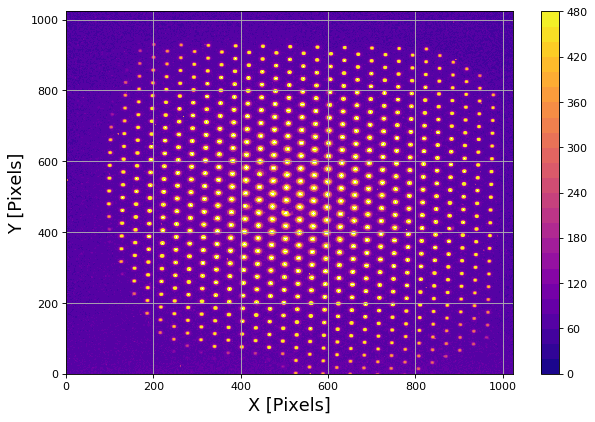

In [11]:
def plot_raw(img):
    data = img['avImage']
    
    fig = pl.figure(figsize=(9, 6), dpi=80)

    ax1=fig.add_subplot(111) # Second row, span all columns
    c_range = range(0,500,20)
    pl.contourf(X,Y,data, c_range, cmap='plasma')
    pl.xlabel("X [Pixels]",fontsize=16)
    pl.ylabel("Y [Pixels]",fontsize=16)
    pl.grid()
    
    pl.colorbar()
    
plot_raw(img_test)

In [12]:
# set up the numerical WF                                                                                                                       
limits = {'x': [-0.1, 0.1], 'y': [-0.1, 0.1]}                                                                                                   
spc = 0.2/200                                                                                                                                   
x_g,y_g = setup_grid(limits,spc)  

png_grad_files = []

def plot_grad(ref_img,cur_img,gps,direc,ifo_dict,optic,min_range,max_range):
    
    ref_grad = np.array(ref_img['avGradients'])
    cur_grad = np.array(cur_img['avGradients'])

    U = +cur_grad[:,0]-ref_grad[:,0]
    V = +cur_grad[:,1]-ref_grad[:,1]
    U = U - np.mean(U)   # remove tilt                                                                                                              
    V = V - np.mean(V)
    rmsV = scipy.mean(scipy.sqrt(U**2 + V**2))

    # set up the numerical WF                                                                                                                                                                                                                                    
    cents = ref_grad[:,2:4] 
    grads = np.transpose([U,V])

    wf = -1E9*calculate_wf(cents,grads,limits,spc)                                                                                                  
    wf = wf-np.max(wf[50:150,50:150])
    
    
    # Determine how to track the linear plot with the gradient plot
    ifo_index = np.where(dict_ifo['Time'][:]==gps)
    if ifo_index[0].size<=0:
        pass
    else:
        ifo_index = int(ifo_index[0])
    
    start_index = int(np.where(dict_ifo['Time'][:]==ifo_hws_times[0])[0])

    ######### Plotting
    gs=GridSpec(5,2) # 3 rows, 2 columns
    fig = pl.figure(figsize=(18, 20), dpi=40)
    
    
    ####
    ax0=fig.add_subplot(gs[0:2,0])
    
    range_max = int(round(wf.max())+15)
    range_min = int(round(wf.min())-15)                                                                                                                                              
    contourR = range(min_range,max_range,2)
    
    theta = arange(-pi/200, 2*pi,pi/200)                                                                                                        
    xITM = 0.17*cos(theta)                                                                                                                      
    yITM = 0.17*sin(theta)                                                                                                                      
    indEdge = np.where(abs(xITM) > 326.5E-3/2)                                                                                                  
    xITM[indEdge] = np.sign(xITM[indEdge])*326.5E-3/2                                                                                           
    pl.plot(xITM, yITM,'b-',linewidth=1)                                                                                                       
    xITM = 0.1686*cos(theta)                                                                                                                    
    yITM = 0.1686*sin(theta)                                                                                                                    
    indEdge = np.where(abs(xITM) > 326.5E-3/2 - 1.41E-3)                                                                                        
    xITM[indEdge] = np.sign(xITM[indEdge])*(326.5E-3/2-1.41E-3)                                                                                 
    pl.plot(xITM, yITM,'b-',linewidth=1)    

    img0 = pl.contourf(x_g,y_g,wf,contourR, cmap=pl.cm.get_cmap('spring'))                                                                    
    cbar=pl.colorbar()                                                                                                                         
    img1 = pl.contour(x_g,y_g,wf,contourR, colors='k', linewidths=1.3,linestyles='solid')                                                      
    cbar.set_label('OPD (nm)')                                                                                                                  
    pl.grid()   

    
    ####
    ax1=fig.add_subplot(gs[0:2,1])
    
    Q2 = pl.quiver(ref_grad[:,2], ref_grad[:,3], U, V, units='x', scale_units='height')

    pl.title('HWS gradient field.\n Current time = '+str(gps))
    pl.xlabel('X coordinate - HWS (m)')                                                                                                        
    pl.ylabel('Y coordinate - HWS (m)')                                                                                                        
    pl.xlim([-0.17, 0.17])                                                                                                                       
    pl.ylim([-0.17, 0.17])                                                                                                                       
                                                                                                                     
    pl.grid()

    ####
    ax3=fig.add_subplot(gs[2,:]) # First row, second column
    pl.plot(dict_ifo['Time'][start_index:ifo_index],dict_ifo[str(optic)+'_CO2_Power'][start_index:ifo_index])
    pl.grid()
    pl.xlim(dict_ifo['Time'][start_index],dict_ifo['Time'][-1])
    
    pl.xlabel('Time (Seconds)')
    pl.ylabel('CO2 Power (Watts)')
    
    ######
    ax4=fig.add_subplot(gs[3,:]) # First row, second column
    pl.plot(dict_ifo['Time'][start_index:ifo_index],dict_ifo['IMC_Power'][start_index:ifo_index])
    
    pl.grid()
    pl.xlim(dict_ifo['Time'][start_index],dict_ifo['Time'][-1])
    
    pl.xlabel('Time (Seconds)')
    pl.ylabel('IMC Power (Watts)')
    
    ######
    ax5=fig.add_subplot(gs[4,:]) # First row, second column
    
    pl.plot(dict_ifo['Time'][start_index:ifo_index],dict_ifo[str(optic)+'_Spherical_Power'][start_index:ifo_index])
    pl.grid()
    pl.xlim(dict_ifo['Time'][start_index],dict_ifo['Time'][-1])
    #pl.ylim(-5e-6,35e-6)
    
    pl.xlabel('Time (Seconds)')
    pl.ylabel('Spherical Power (Diopters)')
    
    save_file = direc+str(gps)+".png"
    png_grad_files.append(save_file)
    pl.savefig(save_file)
    pl.close()

C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:664: RuntimeWarning: divide by zero encountered in double_scalars
  length = a * (widthu_per_lenu / (self.scale * self.width))
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:664: RuntimeWarning: invalid value encountered in multiply
  length = a * (widthu_per_lenu / (self.scale * self.width))
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:720: RuntimeWarning: invalid value encountered in less
  short = np.repeat(length < minsh, 8, axis=1)
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:734: RuntimeWarning: invalid value encountered in less
  tooshort = length < self.minlength
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the r

IndexError: list index out of range

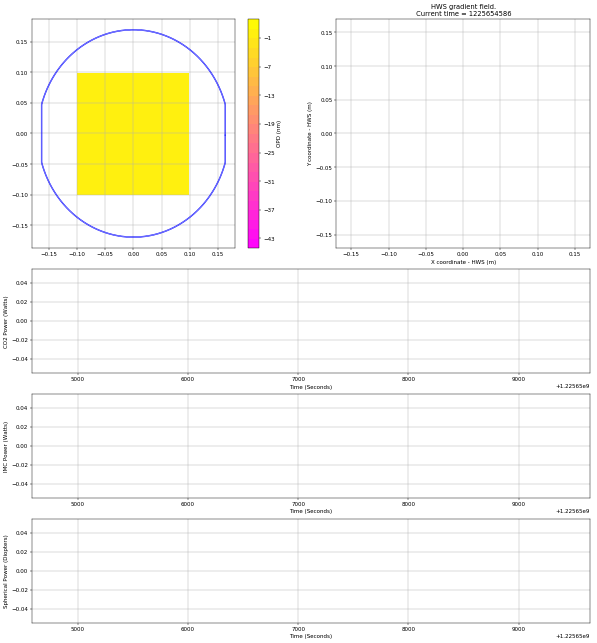

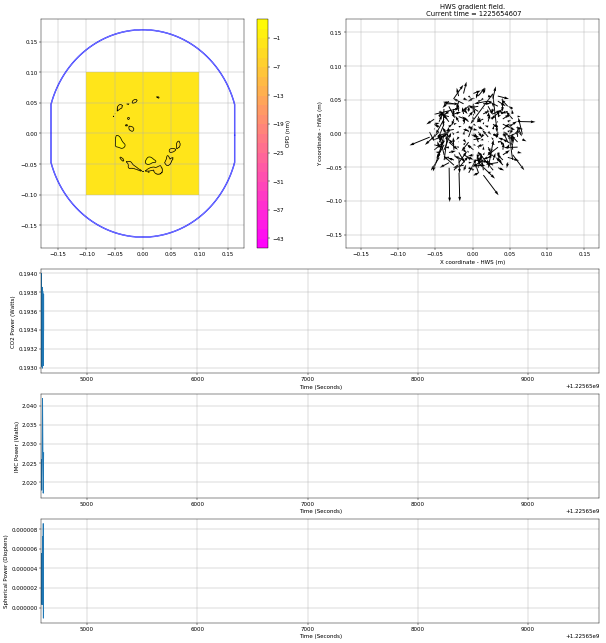

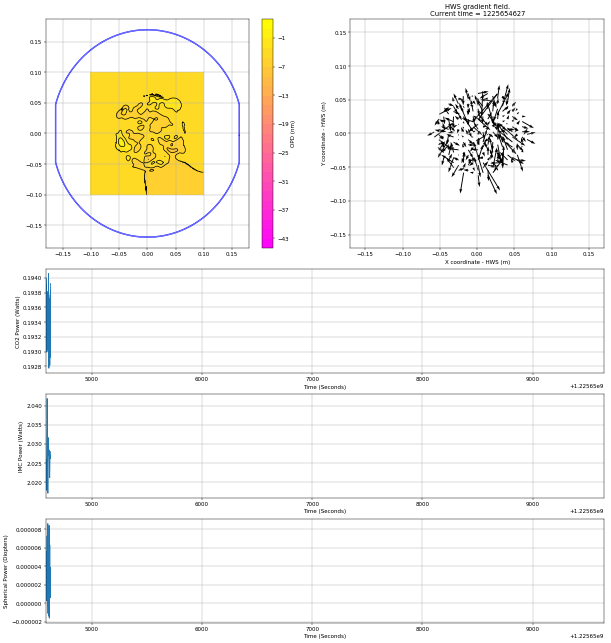

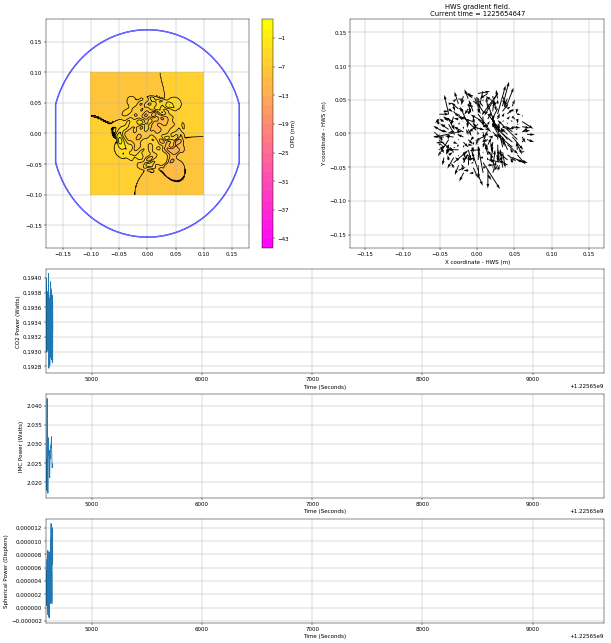

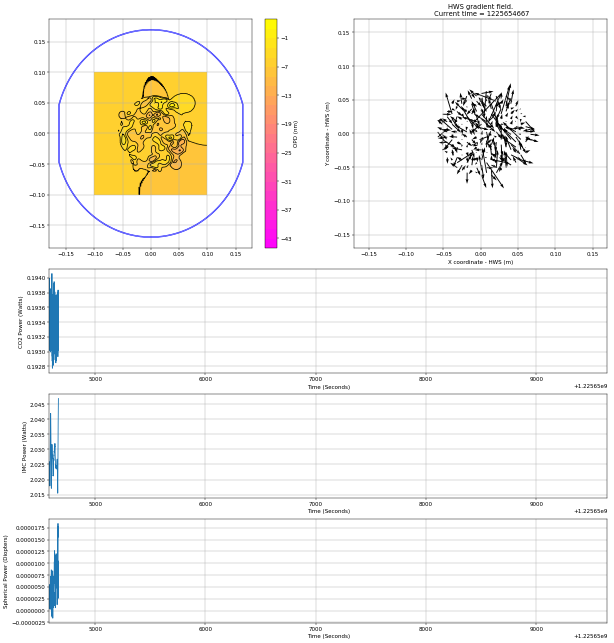

...

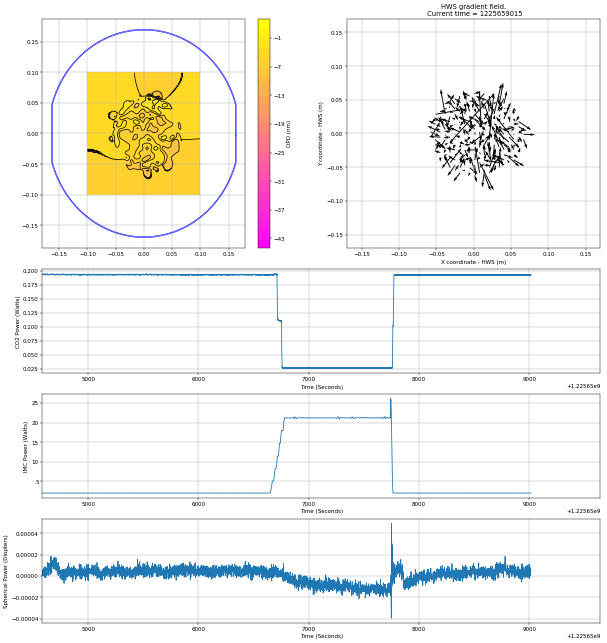

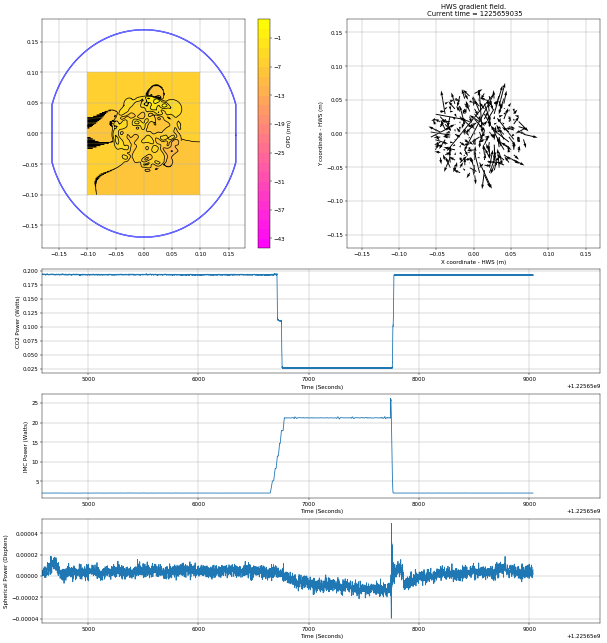

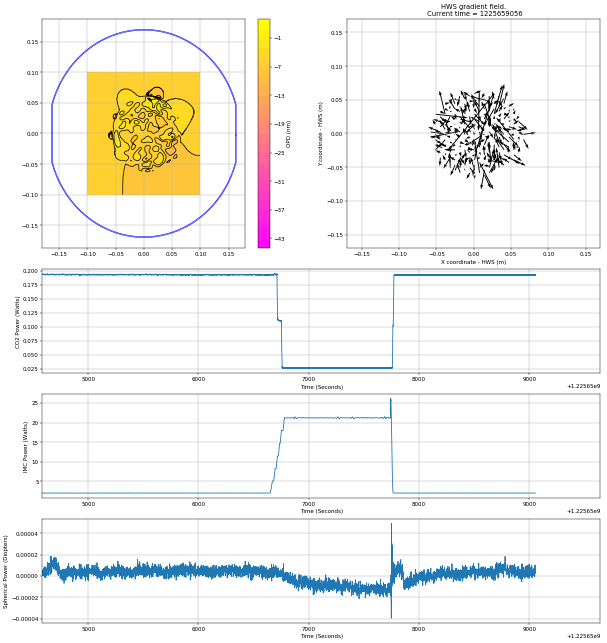

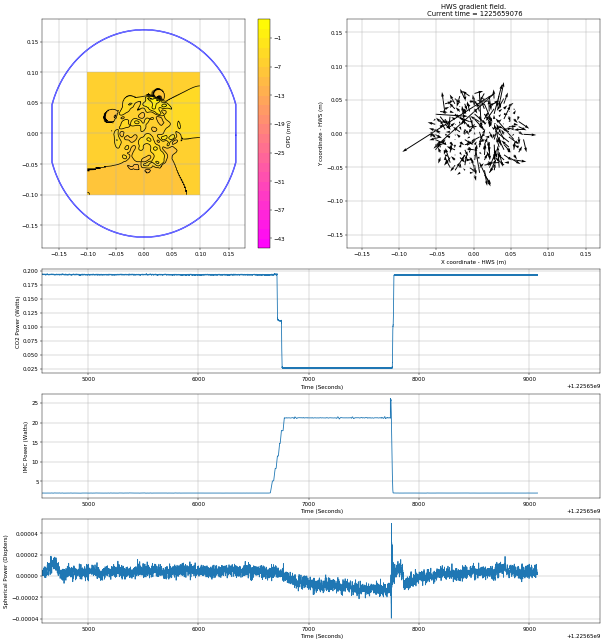

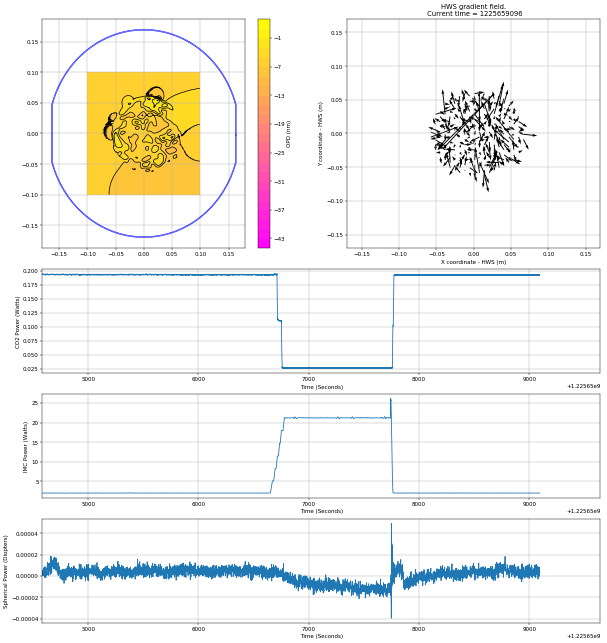

In [67]:
ITMX_direc_png_grad = '../../../20181106_HeatupCooldown/ITMX_grad_pngs/'

for i in range(len(Ximg_gps)):
    try:
        plot_grad(ITMX_list[0],ITMX_list[i],Ximg_gps[i],ITMX_direc_png_grad,dict_ifo,'ITMX',min_range = -45,max_range = 3)
    except IOError as e:
        print("I/O error({0}): {1}".format(e.errno, e.strerror))
        continue

In [13]:
ITMY_direc_png_grad = '../../../20181106_HeatupCooldown/ITMY_grad_pngs/'

for i in range(len(Yimg_gps)):
    try:
        plot_grad(ITMY_list[0],ITMY_list[i],Yimg_gps[i],ITMY_direc_png_grad,dict_ifo,'ITMY',min_range=-150,max_range=10)
    except IOError as e:
        print("I/O error({0}): {1}".format(e.errno, e.strerror))
        continue

C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:664: RuntimeWarning: divide by zero encountered in double_scalars
  length = a * (widthu_per_lenu / (self.scale * self.width))
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:664: RuntimeWarning: invalid value encountered in multiply
  length = a * (widthu_per_lenu / (self.scale * self.width))
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:720: RuntimeWarning: invalid value encountered in less
  short = np.repeat(length < minsh, 8, axis=1)
C:\Users\tvo88\Anaconda3\lib\site-packages\matplotlib\quiver.py:734: RuntimeWarning: invalid value encountered in less
  tooshort = length < self.minlength


In [ ]:
images = []
for i in range(len(png_grad_files)):
        images.append(imageio.imread(png_grad_files[i]))
imageio.mimsave('./20181031_PtAbs.gif', images,duration=.5)